# Современные методы анализа данных и машинного обучения, БИ

## НИУ ВШЭ, 2023-24 учебный год

### Домашнее задание №3. PCA

Задание выполнил(а):

    (впишите свои фамилию и имя)

### Общая информация

__Дата выдачи:__ 14.05.2024

__Дедлайн:__ 04:00 21.05.2024

### Оценивание и штрафы

Количество баллов за каждую задачу данного домашнего задания указано рядом с условием задачи.

Оценка за домашнее задание вычисляется по следующей формуле:

$$
s \times 10/53 ,
$$

где $s$  — количество баллов, которое вы набрали в сумме по всем задачам.

За сдачу задания позже срока на итоговую оценку за задание накладывается штраф в размере 1 **вторичный** балл в день, но  задержка не может быть больше недели.

__Внимание!__ Домашнее задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов.

Кроме того, не забывайте, что все решения прогоняются через специальную новую систему антиплагиата для юпитеровских ноутбуков, которая детектирует перекрестные «похожести» между разными ноутбуками, а также решения, сгенерированные нейросетью. Подобные работы также в обязательном порядке будут расцениваться исключительно как плагиат.

### Формат сдачи

Загрузка файлов с решениями происходит в системе [Anytask](https://anytask.org/). Необходимо загружать файл с расширением .ipynb (питоновский ноутбук)

Инвайт для подключения к странице курса в системе — указан для каждой группы в нашем телеграмм-канале.

### О задании

В данном задании мы потренируемся в работе с линейной алгеброй и, конкретно, — в применении алгоритма PCA. Цель задания — попробовать сжать звуковую дорожку мелодии Бетховена, используя данный алгоритм снижения размерностей, подробно рассмотренный нами на семинарах и лекции.

Для начала импортируем все необходимые библиотеки:

In [1]:
# Понадобится для чтения и записи аудио файлов
from scipy.io import wavfile

# Это нужно для проигрывания аудио файлов прямо в блокноте
from IPython.display import Audio

# А это стандартный набор библиотек анализа данных, необходимый для этого задания
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

Скачаем данные:

In [2]:
! wget https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav

--2024-05-19 14:54:45--  https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Распознаётся www.dropbox.com (www.dropbox.com)… 2620:100:6026:18::a27d:4612, 162.125.70.18
Подключение к www.dropbox.com (www.dropbox.com)|2620:100:6026:18::a27d:4612|:443... соединение установлено.
HTTP-запрос отправлен. Ожидание ответа… 302 Found
Адрес: /s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav [переход]
--2024-05-19 14:54:45--  https://www.dropbox.com/s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Повторное использование соединения с [www.dropbox.com]:443.
HTTP-запрос отправлен. Ожидание ответа… 302 Found
Адрес: https://uc7133364b1b93a63b8d81b24da7.dl.dropboxusercontent.com/cd/0/inline/CTN_HtA587RCWaNrZKMw4sW-PKl3_2O6AicOaOg2zB9DEQrC_a8ItgxQPLruUcC-MHqLT-ONzH6f0wiLdpbl-zAyxfljg2y-syCHHOgWFNOeH83YwntWpFxsc2l5mV1MpLzko8Yj4-86-AcnC-9h2JTW/file# [переход]
--2024-05-19 14:54:45--  https://uc

Прочитаем аудиодорожку при помощи wavfile:


In [3]:
samplerate, data = wavfile.read('Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav')

В ячейке выше мы с вами видим некую `samplerate`. Данная переменная по умолчанию хранит частоту дискретизации; стандартное для аудио значние — 44100 Гц.

Для тех, кто не очень хорошо знаком со способами кодирования и записи звука (aka тех, кто не сдавал в школе ЕГЭ по информатике :) ), — частота дискретизации показывает, сколько последовательных элементов массива с сигналом кодируют звук длительностью 1 секунда.

Подробнее с кодированием звука можно разобраться [тут](https://ru.wikipedia.org/wiki/Кодирование_звуковой_информации).

Итак, посмотрим, какая же частота дискретизации у нашей аудиодорожки.

In [4]:
samplerate

44100

Если поделить длину массива сигнала на `samplerate`, получится длительность аудиодорожки в секундах. По крайней мере — должна получиться!


In [5]:
len(data) / samplerate

45.139591836734695

Сорок пять секунд с небольшим. Похоже на правду? Сравните с длиной дорожки, запустив её у себя на компьютере.

Заметим также, что звук — стерео, так как сигнал кодируется двумя каналами (для левого и правого динамика).


In [6]:
data.shape

(1990656, 2)

Отрисуем сигналы в обоих каналах:

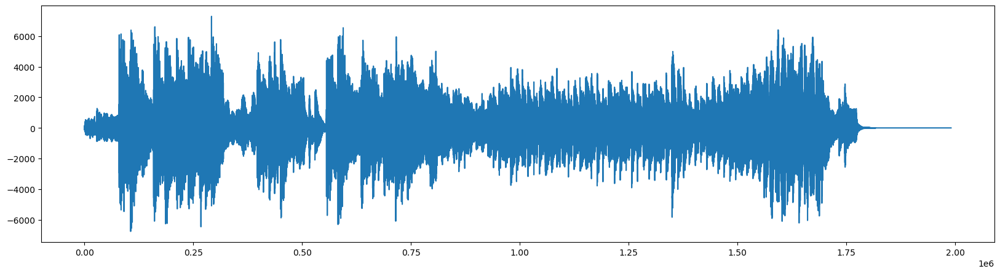

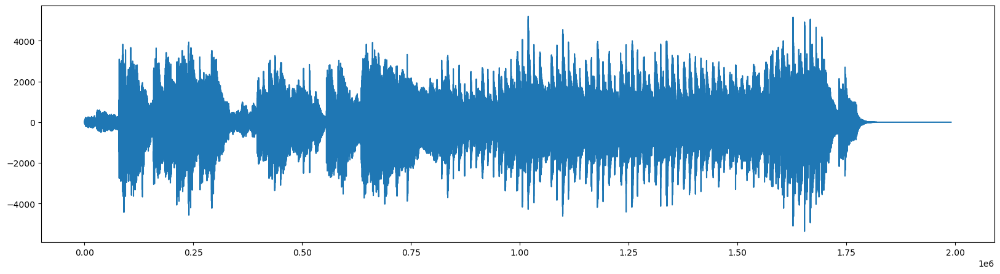

In [7]:
# Канал 1
plt.figure(figsize=(20,5))
plt.plot(data[:,0])
plt.show()

# Канал 2
plt.figure(figsize=(20,5))
plt.plot(data[:,1])
plt.show()

Вот она — легендарная «кардиограмма» звука, с которой мы все хорошо знакомы! :)

Итак, давайте теперь усредним каналы и получим монозвук, с которым будет существенно проще работать.


In [8]:
mono_sound = np.mean(data, axis=1)
mono_sound.shape

(1990656,)

Ну и теперь мы, наконец, готовы послушать то, что нам собственно предстоит сжимать! :)

In [9]:
Audio(mono_sound, rate = samplerate)

Прелестно, не правда ли? :)

Для удобства мы также обрежем массив с сигналом таким образом, чтобы его проще было делить на равные части, датасет из которых и необходимо будет сжать известными вам методами.

На самом деле, способ очень похож на тот, которым мы сжимали картинку на семинаре, разбивая её на прямоугольные подкартинки — только здесь задача по большому счету еще проще :)

In [10]:
mono_sound_to_cut = mono_sound[:1990000]

Проверим, что наш звук теперь — это просто вектор чисел:

In [11]:
mono_sound_to_cut.shape

(1990000,)

Замечательно, всё абсолютно готово!

Ну что же, на этом наша миссия — всё; теперь — ваш выход! :)

### Задание 1


#### 1.1. (2 балла)
Напишите функцию, которая будет разделять сигнал на равные части длиной 1000 и собирать из них "датасет", представляющий собой двумерный массив — матрицу объектов-признаков (каждая часть сигнала длины 1000 находится в отдельной строке).

In [22]:
mono_sound_to_cut

array([ 0., -1., -1., ...,  0.,  0.,  0.])

In [36]:
def cutSound(sound):
    return sound.reshape(-1, 1000)

In [37]:
cutSound(mono_sound_to_cut)

array([[  0. ,  -1. ,  -1. , ...,  88.5,  58.5,  18. ],
       [-25.5, -61.5, -81.5, ...,  30.5, -20.5, -53. ],
       [-67.5, -65.5, -50. , ..., 118.5, 118.5,  86.5],
       ...,
       [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ],
       [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ],
       [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ]])

In [38]:
cutSound(mono_sound_to_cut).shape

(1990, 1000)

#### 1.2. (3 балла)

Напишите функцию, которая будет переводить вашу "матрицу" обратно в звуковой сигнал. Иными словами функция разворачивает данные из матрицы размера `(число объектов, 1000)` в вектор длины `(число объектов * 1000)`.

Запустите функцию и проверьте, что все работает корректно, путем воспроизведения "востановленного" сигнала в ноутбуке — этот сигнал должен в точности совпасть с изначальным (ведь, на самом деле, им и является).

In [40]:
def recutSound(sound):
    return sound.reshape(-1)

In [41]:
recutSound(cutSound(mono_sound_to_cut))

array([ 0., -1., -1., ...,  0.,  0.,  0.])

In [42]:
np.equal(recutSound(cutSound(mono_sound_to_cut)), mono_sound_to_cut).all()

True

### Задание 2





#### 2.1. (3 балла)

Выполните PCA-преобразование нашей матрицы и получите данные, сжатые в пространство меньшей размерности.

_Подсказка. На этом этапе у нас есть наш "датасет" с 1000 "признаками" и мы хотим уменьшить число "признаков" путем применения метода PCA. Число компонент предлагается выбрать вам, но для начала не стоит брать слишком маленькое число, чтобы потом было проще понять, в случае плохого результата: это компонент оказалось недостаточно или же это вы где-то ошиблись :)_

    

In [43]:
mono_sound = cutSound(mono_sound_to_cut)

In [47]:
pca = PCA(n_components=50)
Y = pca.fit_transform(mono_sound)
mono_sound_hat = pca.inverse_transform(Y)

In [48]:
Y.shape

(1990, 50)

In [49]:
mono_sound_hat

array([[ 24.4364131 ,  29.61556483,  33.13696973, ...,  36.79431922,
         34.16181031,  32.30946342],
       [ 33.70382875,  35.79211155,  34.97087676, ...,  29.60338217,
         25.79651331,  24.85289611],
       [118.00326462, 113.53109874, 104.85641798, ...,  -6.27917541,
          1.21388435,  13.5274346 ],
       ...,
       [  4.92980287,   4.98832452,   4.02677405, ...,  -1.89681098,
         -1.71287098,  -1.58886189],
       [  4.92980287,   4.98832452,   4.02677405, ...,  -1.89681098,
         -1.71287098,  -1.58886189],
       [  4.92980287,   4.98832452,   4.02677405, ...,  -1.89681098,
         -1.71287098,  -1.58886189]])

In [50]:
Audio(recutSound(mono_sound_hat), rate = samplerate)

#### 2.2. (4 балла)

Визуализируйте наши "объекты" в наглядной форме на плоскости. Сделайте выводы исходя из их вида.

_Подсказка. Для этого вам необходимо применить PCA некоторым специальным образом, который мы в том числе обсуждали на семинаре._

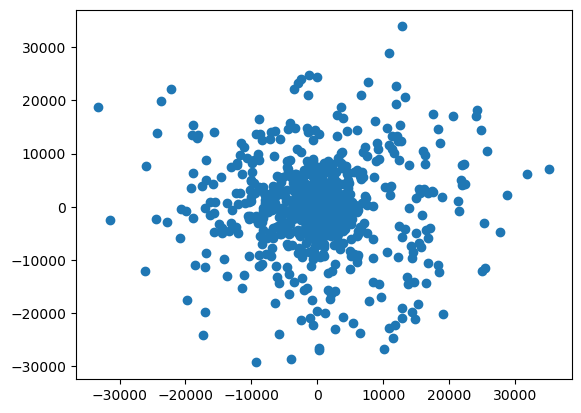

In [61]:
pca = PCA(n_components=2)
Y = pca.fit_transform(mono_sound)

#plt.xlim([-1000, 1000])
#plt.ylim([-1000, 1000])
plt.scatter(Y[:, 0], Y[:, 1])

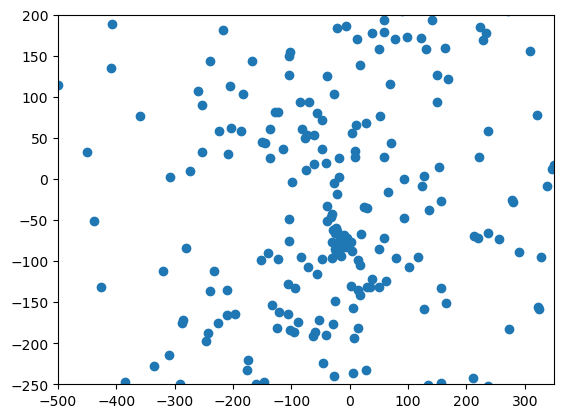

In [59]:
plt.xlim([-500, 350])
plt.ylim([-250, 200])
plt.scatter(Y[:, 0], Y[:, 1])

In [64]:
pca.components_# > -1000# and pca.components_ < -1000

array([[ 0.01627637,  0.01771341,  0.01922992, ...,  0.01568176,
         0.01401767,  0.0124308 ],
       [-0.05163401, -0.05312214, -0.05456644, ...,  0.0536094 ,
         0.05183346,  0.05005153]])

#### 2.3. (4 балла)

Постройте scatter plot датасета в пространстве, задействовав цвет. Сделайте выводы из этого графика. Что вообще изображено?

_Подсказка. Так мы тоже делали на семинаре. Это еще один другой вариант специального применения PCA._

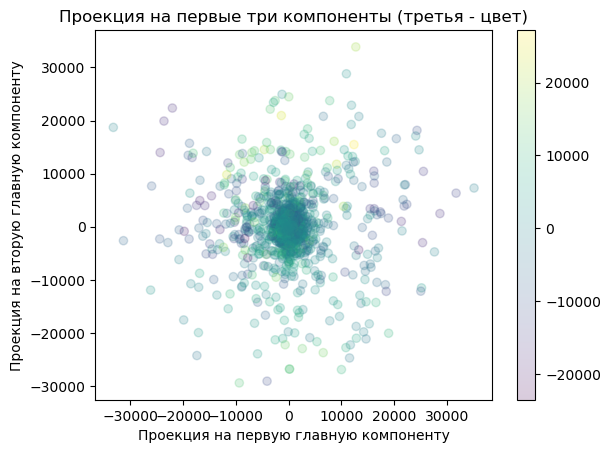

In [67]:
pca = PCA(n_components=3)
Y = pca.fit_transform(mono_sound)
#mono_sound_hat = pca.inverse_transform(Y)

plt.scatter(Y[:, 0], Y[:, 1], c=Y[:, 2], alpha=0.2)
plt.xlabel('Проекция на первую главную компоненту')
plt.ylabel('Проекция на вторую главную компоненту')
plt.title('Проекция на первые три компоненты (третья - цвет)')
plt.colorbar()
plt.show()

### Задание 3

Нам осталось заняться непосредственно "сжатием" звука и проверкой правильности наших действий.

#### 3.1. (4 балла)

Выполните обратное PCA-преобразование сжатых данных и получите "матрицу" со сжатым звуком. Каков будет размер полученной матрицы?

In [70]:
pca = PCA(n_components=50)
Y = pca.fit_transform(mono_sound)
mono_sound_hat = pca.inverse_transform(Y)

In [71]:
mono_sound_hat.shape

(1990, 1000)

#### 3.2. (4 балла)

Преобразуйте "матрицу", получившуюся в предыдущем пункте, в сигнал, который можно проиграть (наш "сжатый" монозвук). Воспроизведите результат `(Audio(YOUR_RESULT, rate = samplerate)`.

Похож ли полученный звук на оригинал?

In [72]:
Audio(recutSound(mono_sound_hat), rate = samplerate)

#### 3.3. (8 баллов)

Проведите исследование зависимости качества звука от числа компонент.

Подберите "на слух" минимальное число компонент, при котором звук практически не отличается от оригинала.

Добавьте в ячейки два варианта звуковой дорожки: оригинальную и выбранную вами. Укажите, какое число компонент вы оставили.

_Подсказка. Попробуйте отфильтровать сигнал с помощью функции `gaussian_filter1d` из `scipy.ndimage`. Это поможет убрать неприятный дробовой шум при сильном сжатии. Вы поймете, о чем идет речь, когда попробуете это на практике._

_Пример кода для фильтрации: `Audio(gaussian_filter1d(mono_sound_compressed, 2), rate = samplerate)`_

In [90]:
from scipy.ndimage import gaussian_filter1d

In [101]:
pca = PCA(n_components=70)
Y = pca.fit_transform(mono_sound)
mono_sound_hat = pca.inverse_transform(Y)
Audio(gaussian_filter1d(recutSound(mono_sound_hat), 2), rate = samplerate)

In [102]:
Audio(recutSound(mono_sound_hat), rate = samplerate)

In [103]:
Audio(mono_sound_to_cut, rate = samplerate)

(array([1.48000e+02, 2.47800e+03, 2.60820e+04, 2.31124e+05, 1.14862e+06,
        4.95362e+05, 7.61880e+04, 8.99500e+03, 9.66000e+02, 3.70000e+01]),
 array([-4664. , -3677.8, -2691.6, -1705.4,  -719.2,   267. ,  1253.2,
         2239.4,  3225.6,  4211.8,  5198. ]),
 <BarContainer object of 10 artists>)

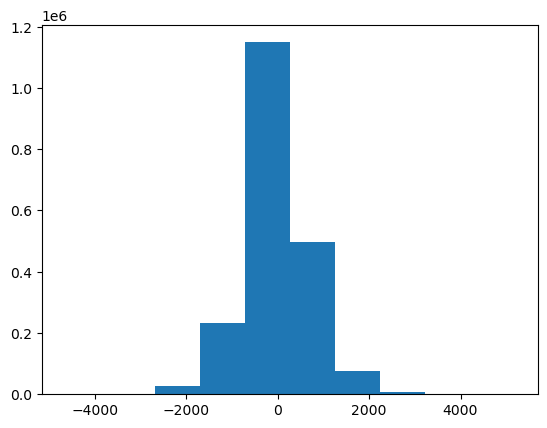

In [104]:
plt.hist(mono_sound_to_cut)

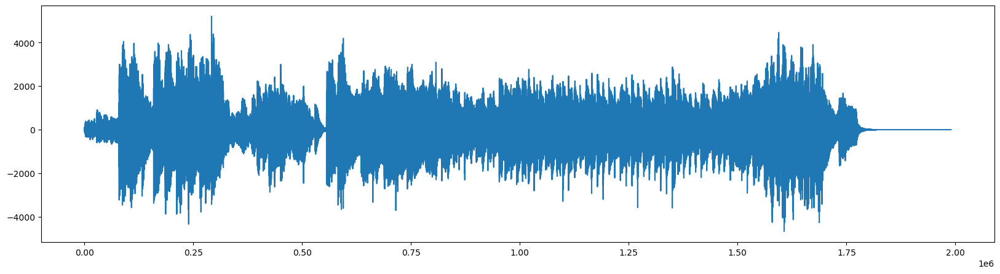

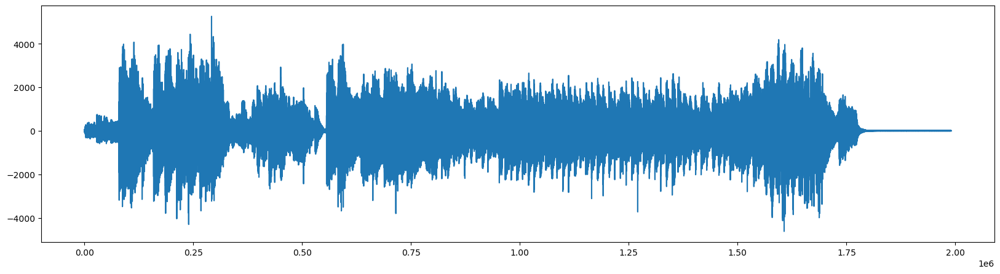

In [105]:
plt.figure(figsize=(20,5))
plt.plot(mono_sound_to_cut)
plt.show()

plt.figure(figsize=(20,5))
plt.plot(recutSound(mono_sound_hat))
plt.show()

In [112]:
np.allclose(recutSound(mono_sound_hat), mono_sound_to_cut, atol=2000)

True

вот это не работает, но по графикам видно попадание, шумы имеются, но слушать можно. Это благородный эффект изношенной пластинки или радиомагнитофона из советского союза.
оставил 70 компонент

#### 3.4. (6 баллов)
Аргументированно ответьте на следующие вопросы:
- Количество компонент, которое вы выбрали, это много или мало? Как это можно понять?
- Как сильно можно сжать звук таким образом? Какая оптимизация по памяти у вас получилась в ходе проделанной работы?
- Если нам дадут другую звуковую дорожку, нам нужно будет проделать всё то же самое, чтобы сжать звук. Как автоматически подобрать число компонент и возможно ли это?




    # Ваш ответ здесь

### Задание 4

#### Дополнительное исследование. (15 баллов)
  
  - Оберните получившийся код по сжатию звука в одну или несколько функций.

  - Проведите исследование того, как степень сжатия — соотношение размера частей, на которые делился сигнал в задании 1.1, и размера пространсва, в которое вы сжимали данные с помощью PCA — влияет на звук, по субъективным ощущениям. Начиная с какой степени сжатия сильно заметна потеря качества аудиодорожки? (Как с учетом фильтрации с помощью `gaussian_filter1d`, так и без неё).

  - Что степень сжатия означает для PCA? Для большой аудиозаписи (3 мин, например) мы хотели бы разбить на большее, меньшее или такое же число отрезков как и для предложенной аудиозаписи? Почему?

  - Можно ли как-то автоматически подобрать степерь сжатия? За что она отвечает в нашей задаче? Как степень сжатия влияет на звук? Почему она так влияет на звук?



In [ ]:
def PCA_to_audio(n_components, gaussian=True):
    pca = PCA(n_components=70)
    Y = pca.fit_transform(mono_sound)
    mono_sound_hat = pca.inverse_transform(Y)
    Audio(gaussian_filter1d(recutSound(mono_sound_hat), 2), rate = samplerate)

Критерий локтя

In [2]:
np.cumsum(pca.explained_variance_ratio_)

NameError: name 'np' is not defined

In [125]:
delta = 0.95
y = np.cumsum(pca.explained_variance_ratio_)
70 - (y > delta).sum() + 1

52

In [121]:
y > delta

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True])